<a href="https://colab.research.google.com/github/miguelamda/DL/blob/master/Ejercicios/Ejercicio2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Ejercicio 4. Segmentación de Imágenes con U-Net

En este ejercicio trabajaremos con un ejemplo de Keras, donde se entrena un modelo para la segmentación de imágenes mediante un modelo de tipo U-Net. Un modelo de este tipo es básicamente un autoencoder, donde cada bloque de capas en el encoder está conectado mediante una conexión residual al bloque de capas simétrico en el decoder. Un ejemplo:

![mask](img/u-net-architecture.png)

Este tipo de modelos se emplean sobre todo en el tratamiento de imágenes médicas, pero el ejemplo que vamos a trabajar está diseñado para inferir la máscara de segmentación de imágenes de mascotas. El ejemplo en concreto es [este](https://keras.io/examples/vision/oxford_pets_image_segmentation/).

## 1. Enunciado

Reproducir el ejemplo de Keras para la [segmentación de imágenes con un modelo de tipo U-Net](https://keras.io/examples/vision/oxford_pets_image_segmentation/), y probar **2 variantes** distintas de modelo, jugando con los *filtros en cada bloque* y con el *número de bloques*. Se hará una comparativa cualitativa, con 5 ejemplos distintos del dataset, y 5 imágenes de mascotas obtenidas de Internet (o propias).

## 2. Entrega

La entrega de este ejercicio se realiza a través de la tarea creada para tal efecto en Enseñanza Virtual. Tienes que entregar un notebook, y el HTML generado a partir de él, cuyas celdas estén ya evaluadas.

La estructura del notebook debe contener los siguientes apartados:

0. Cabecera: nombre y apellidos.
1. Preparación de los datos para ser usados en Keras.
2. Modelos y configuraciones creados en Keras, razonando la modificación hecha al modelo original del ejemplo
3. Entrenamiento y evaluación de cada modelo creado (un sub-apartado para cada uno). 
4. Evaluación de los modelos.
5. Bibliografía utilizada (enlaces web, material de clase, libros, etc.).

### 2.1. Nota importante
-----
**HONESTIDAD ACADÉMICA Y COPIAS: un trabajo práctico es un examen, por lo que
debe realizarse de manera individual. La discusión y el intercambio de
información de carácter general con los compañeros se permite (e incluso se
recomienda), pero NO AL NIVEL DE CÓDIGO. Igualmente el remitir código de
terceros, OBTENIDO A TRAVÉS DE LA RED o cualquier otro medio, se considerará
plagio.** 

**Cualquier plagio o compartición de código que se detecte significará
automáticamente la calificación de CERO EN LA ASIGNATURA para TODOS los
alumnos involucrados. Por tanto a estos alumnos NO se les conservará, para
futuras convocatorias, ninguna nota que hubiesen obtenido hasta el momento.
SIN PERJUICIO DE OTRAS MEDIDAS DE CARÁCTER DISCIPLINARIO QUE SE PUDIERAN
TOMAR.**

-----

## 3. Dataset

La celda para descargar el dataset en el ejemplo hace uso de `curl`, pero la descarga puede fallar (al menos en Google Colab). La descarga falla porque la descompresión con tar falla. En tal caso, recomiendo sustituir el comando `curl -O` por `wget`, para ambos ficheros del dataset.

In [ ]:
#Comentado para que no se pare aqui mi ejecución

In [1]:
#!curl -O https://thor.robots.ox.ac.uk/datasets/pets/images.tar.gz
#!curl -O https://thor.robots.ox.ac.uk/datasets/pets/annotations.tar.gz

In [2]:
#!tar -xf images.tar.gz
#!tar -xf annotations.tar.gz

#  Alfonso Alarcón Tamayo


# Preparación de los datos para ser usados en Keras.


Bueno en primer lugar tendremos que tener descargado el conjunto de imágenes y en mi caso localizarlo en la misma ubicación que este archivo, ya que estoy en jupyter en anaconda, el conjunto esta en las carpetas images y anotations respectivamente

In [3]:
import os

images_dir="images/"
trimaps_dir="annotations/trimaps/"

#tamaño de las imágenes
img_size= (160,160)

# representaciones (mascota,contorno y fondo)
num_classes=3

batch_size=64

# Ordenamos el conjunto de imagenes y los mapas para que esten en el mismo orden
def ordenar(directory, extension):
    file_paths = sorted([
        os.path.join(directory, fname)
        for fname in os.listdir(directory)
        if fname.endswith(extension) and not fname.startswith(".")
    ])
    print(f"Number of elements in {directory}: {len(file_paths)}")
    return file_paths


input_img_paths = ordenar(images_dir, ".jpg")
target_img_paths = ordenar(trimaps_dir, ".png")

Number of elements in images/: 7390
Number of elements in annotations/trimaps/: 7390


Vamos a ver un ejemplo para comprobar que se han guardado bien las imagenes y sus respectivas máscaras

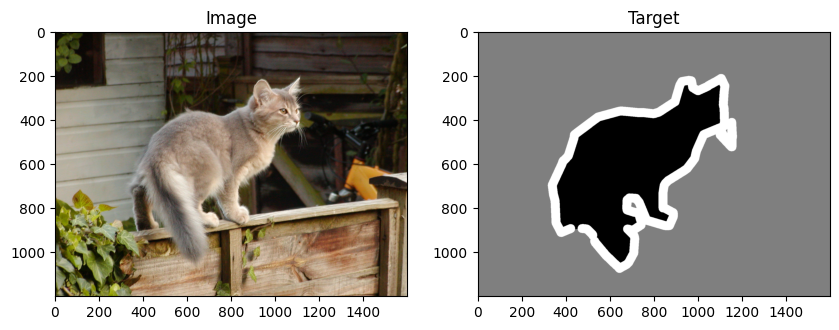

In [4]:
from IPython.display import Image, display
from keras.utils import load_img
from PIL import ImageOps
import matplotlib.pyplot as plt

# Obtener las rutas de las imágenes
input_path = input_img_paths[76]
target_path = target_img_paths[76]

# Cargar las imágenes
input_img = load_img(input_path)
target_img = ImageOps.autocontrast(load_img(target_path))

# Creo dos subgráficos
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Mostrar la imagen de entrada en el primer subgráfico
axes[0].imshow(input_img)
axes[0].set_title('Image')

# Mostrar la mascara en el segundo subgráfico
axes[1].imshow(target_img)
axes[1].set_title('Target')

#plt.tight_layout()
plt.show()


Ahora importamos el método del ejemplo de keras para generar el conjunto, aqui lo que esta haciendo es crear el dataset  y con el load_img_maks:
carga las imágenes, las decodifica, las redimensiona al tamaño de 160x160 que hemos especificado y las convierte, para el encoder tiene 3 canales ya que es a color y el decoder para la máscara 1 porque es en blanco y negro

In [5]:
import keras
import numpy as np
from tensorflow import data as tf_data
from tensorflow import image as tf_image
from tensorflow import io as tf_io


def get_dataset(
    batch_size,
    img_size,
    input_img_paths,
    target_img_paths,
    max_dataset_len=None,
):
    """Returns a TF Dataset."""

    def load_img_masks(input_img_path, target_img_path):
        input_img = tf_io.read_file(input_img_path)
        input_img = tf_io.decode_png(input_img, channels=3)
        input_img = tf_image.resize(input_img, img_size)
        input_img = tf_image.convert_image_dtype(input_img, "float32")

        target_img = tf_io.read_file(target_img_path)
        target_img = tf_io.decode_png(target_img, channels=1)
        target_img = tf_image.resize(target_img, img_size, method="nearest")
        target_img = tf_image.convert_image_dtype(target_img, "uint8")

        # como empieza en 1 restar uno para ir desde 0
        target_img -= 1
        return input_img, target_img

    # Reducir el tamaño
    if max_dataset_len:
        input_img_paths = input_img_paths[:max_dataset_len]
        target_img_paths = target_img_paths[:max_dataset_len]
    dataset = tf_data.Dataset.from_tensor_slices((input_img_paths, target_img_paths))
    dataset = dataset.map(load_img_masks, num_parallel_calls=tf_data.AUTOTUNE)
    return dataset.batch(batch_size)

Por último generamos de forma aleatoria y estratificada un conjunto de entrenamiento y validación, he dado un 80-20 aproximadamente.

In [6]:
import  random

aletoriedad = random.randint(1, 1000)
#Barajamos el conjunto
random.Random(aletoriedad).shuffle(input_img_paths)
random.Random(aletoriedad).shuffle(target_img_paths)

# vamos a darles un 20% a validación que es un total de unos 1500 elementos
train_images = input_img_paths[1500:]
train_target = target_img_paths[1500:]

val_images= input_img_paths[:1500]
val_target = target_img_paths[:1500]


train_dataset = get_dataset(batch_size,img_size,train_images,train_target,max_dataset_len=1000,)
valid_dataset = get_dataset(batch_size,img_size,val_images,val_target)

# Modelos y configuraciones creados en Keras, razonando la modificación hecha al modelo original del ejemplo


## <center> Modelo 1</center>

En este primer modelo vamos a adaptar el método getmodel del ejemplo intentando adaptarlo mejor a nuestros datos , lo que he cambiado ha sido:

* Nº filtros: He aumentado por una parte el número de filtros iniciales para que el modelo tenga una mayor capacidad para capturar características en la entrada.
* Aumentando el número de filtros intento que el modelo aprenda características mas complejas y así pueda generalizar mejor ya que en el  ejemplo tenía problemas para diferenciar en muchos casos a animales de elementos del entorno

* Bloques: Como en el ejemplo, la pérdida del conjunto de validación era  más alta que en el entrenamiento, eso significa que el modelo presenta algo de sobreajuste, he introducido un par de capas de dropout para reducir este problema 

* Learning rate: Haciendo pruebas con el lr encontré que en mi modelo con un learning rate algo mayor el rendimiento de este mejoró levemente.


In [18]:
from keras import layers


def get_model2(img_size, num_classes):
    inputs = keras.Input(shape=img_size + (3,))

    ### [First half of the network: downsampling inputs] ###

    # Entrada
    x = layers.Conv2D(64, 3, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    # residual
    previous_block_activation = x  

 
    for filters in [128,256,512]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)
        
        #Añadimos una capa aqui de dropdout para reducir el sobreajuste
        x = layers.Dropout(0.3)(x) 
        
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)


        # residual
        residual = layers.Conv2D(filters, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual



    for filters in [512,256,128, 64]:
        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        #Añadimos una capa en el decoder tb para intentar reducir el sobreajuste del modelo del ejemplo
        x = layers.Dropout(0.3)(x) 

        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.UpSampling2D(2)(x)


        # Project residual
        residual = layers.UpSampling2D(2)(previous_block_activation)
        residual = layers.Conv2D(filters, 1, padding="same")(residual)
        x = layers.add([x, residual])  
        previous_block_activation = x  

    # clasificacion por pixel
    outputs = layers.Conv2D(num_classes, 3, activation="softmax", padding="same")(x)


    # Creamos el modelo
    model2 = keras.Model(inputs, outputs)
    return model2


# montamos y mostramos la estructura
model2 = get_model2(img_size, num_classes)
model2.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_18 (Conv2D)             (None, 80, 80, 64)   1792        ['input_3[0][0]']                
                                                                                                  
 batch_normalization_23 (BatchN  (None, 80, 80, 64)  256         ['conv2d_18[0][0]']              
 ormalization)                                                                                    
                                                                                            

## <center> Modelo 2</center>

En este segundo modelo lo que he intentado es reducir el modelo, ya que el anterior funciona bien pero es muy lento y tarda mucho (con tantos filtros y capas terminábamos con 8 millones de parametros), por lo que he intentado un modelo más simple(con menos características) con lo que tener un modelo simple pero más rápido que detecte a los animales aunque no los dibuje tan bien:

Probe en un principio a reducir aún más el número de capas y filtros, tambien cambié el MaxPooling por un AveragePooling y reducí el kernel de 3 a 2 esperando así simplificar el modelo, pero lo que me encontré fue que el modelo aunque fuese más rápido, tenía serias dificultades para detectar los bordes de los animales, se acercaba a la silueta del animal, pero marcaba mucho más imagen de lo que correspondedia, el modelo presentaba serios problemas para detectar características relevantes del animal para diferenciarlo del fondo, por eso al final opte por una versión del modelo 1 pero reduciendo la complejidad, así obtuve un paso intermedio entre el modelo desechado y el 1 donde se puede observar la silueta del animal, aunque no esté enteramente definida

* Nº filtros: En este caso he reducido los filtros de las capa inicialiales e intermedias, así el modelo capturará menos características en la entrada y en los filtros siguientes

* Bloques: He eliminado parte del bloque y además aunque había en un principio implementado en este caso tambien dropout para evitar el sobreajuste, pero con la reducción del modelo,al final el sobreajuste es mucho mas leve por lo que al final lo he eliminado, ya que empeoraba levemente el modelo.

Con estos cambios obtengo un modelo como ya he comentado más pequeño(pasando de 8 millones a 300.000 parámetros), pero más rápido, los resultados son menos definidos , ya que detecta más o menos los animales en la imágen, pero el contorno y el silueta no están totalmente definidos, un modelo así por ejemplo podría ser mejor para la detección simplemente.


In [19]:
from keras import layers


def get_model(img_size, num_classes):
    inputs = keras.Input(shape=img_size + (3,))

    ### [First half of the network: downsampling inputs] ###

    # Entry block
    x = layers.Conv2D(16, 3, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

    # Blocks 1, 2, 3 are identical apart from the feature depth.
    for filters in [32,64, 128]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)



        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
        residual = layers.Conv2D(filters, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual]) 
        previous_block_activation = x  

    ### [Second half of the network: upsampling inputs] ###

    for filters in [128, 64,32, 16]:
        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)


        x = layers.UpSampling2D(2)(x)

        #  residual
        residual = layers.UpSampling2D(2)(previous_block_activation)
        residual = layers.Conv2D(filters, 1, padding="same")(residual)
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    # clasificacion por pixel
    outputs = layers.Conv2D(num_classes, 3, activation="softmax", padding="same")(x)

    # creamos el modelo
    model = keras.Model(inputs, outputs)
    return model


# lo mostramos
model = get_model(img_size, num_classes)
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_27 (Conv2D)             (None, 80, 80, 16)   448         ['input_4[0][0]']                
                                                                                                  
 batch_normalization_38 (BatchN  (None, 80, 80, 16)  64          ['conv2d_27[0][0]']              
 ormalization)                                                                                    
                                                                                            

# Entrenamiento y evaluación de cada modelo creado (un sub-apartado para cada uno). 

## <center> Modelo 1</center>

Este primer modelo llega a un resultado mejor , pero el tiempo de entrenamiento es mucho mayor, ya que el modelo es mucho más grande,podemos observar que aproximadamente alrededor de la época 30 el modelo se estanca un poco ya que la pérdida en validación desde este punto empieza a aumentar mientras que en el de entrenamiento prácticamente no mejora desde ese punto.

In [20]:
# He incrementado el lr consiguiendo así una mejora en el modelo
model2.compile(optimizer=keras.optimizers.Adam(0.001), loss="sparse_categorical_crossentropy")

callbacks = [
    keras.callbacks.ModelCheckpoint("oxford_segmentation.keras", save_best_only=True)
]

# vamos a usar el mismo nº de epochs y demás valores que el ejemplo para ver bien como varía los modelos y el rendimiento con
#mis cambios
epochs = 50
model2.fit(
    train_dataset,
    epochs=epochs,
    validation_data=valid_dataset,
    callbacks=callbacks,
    verbose=2,
)

Epoch 1/50
16/16 - 7s - loss: 5.3913 - val_loss: 371.7102 - 7s/epoch - 463ms/step
Epoch 2/50
16/16 - 5s - loss: 0.8953 - val_loss: 38.6621 - 5s/epoch - 339ms/step
Epoch 3/50
16/16 - 5s - loss: 0.7530 - val_loss: 3.5696 - 5s/epoch - 338ms/step
Epoch 4/50
16/16 - 6s - loss: 0.7096 - val_loss: 1.2586 - 6s/epoch - 350ms/step
Epoch 5/50
16/16 - 5s - loss: 0.6873 - val_loss: 1.2675 - 5s/epoch - 332ms/step
Epoch 6/50
16/16 - 5s - loss: 0.6693 - val_loss: 1.3208 - 5s/epoch - 335ms/step
Epoch 7/50
16/16 - 5s - loss: 0.6536 - val_loss: 1.3892 - 5s/epoch - 331ms/step
Epoch 8/50
16/16 - 5s - loss: 0.6364 - val_loss: 1.4652 - 5s/epoch - 340ms/step
Epoch 9/50
16/16 - 5s - loss: 0.6206 - val_loss: 1.5301 - 5s/epoch - 342ms/step
Epoch 10/50
16/16 - 5s - loss: 0.6050 - val_loss: 1.6333 - 5s/epoch - 343ms/step
Epoch 11/50
16/16 - 5s - loss: 0.5896 - val_loss: 1.6732 - 5s/epoch - 330ms/step
Epoch 12/50
16/16 - 5s - loss: 0.5763 - val_loss: 1.8008 - 5s/epoch - 327ms/step
Epoch 13/50
16/16 - 5s - loss: 0.5

## <center> Modelo 2</center>

Este segundo modelo es algo mas estable con respecto a los dos conjuntos ya que la perdida en ambos es muy parecida por lo que el sobrejuste es mínimo, aún sin dropout simplificando la entrada y el modelo tanto en filtros o bloques ha conseguido un valor de perdida parecido y pequeño para ambos.

In [21]:
model.compile(optimizer=keras.optimizers.Adam(1e-4), loss="sparse_categorical_crossentropy")

callbacks = [
    keras.callbacks.ModelCheckpoint("oxford_segmentation.keras", save_best_only=True)
]


epochs = 50
model.fit(
    train_dataset,
    epochs=epochs,
    validation_data=valid_dataset,
    callbacks=callbacks,
    verbose=2,
)

Epoch 1/50
16/16 - 2s - loss: 1.9886 - val_loss: 1.8274 - 2s/epoch - 149ms/step
Epoch 2/50
16/16 - 1s - loss: 1.3059 - val_loss: 1.4989 - 1s/epoch - 76ms/step
Epoch 3/50
16/16 - 1s - loss: 1.1048 - val_loss: 1.3380 - 1s/epoch - 74ms/step
Epoch 4/50
16/16 - 1s - loss: 1.0009 - val_loss: 1.2351 - 1s/epoch - 72ms/step
Epoch 5/50
16/16 - 1s - loss: 0.9372 - val_loss: 1.2413 - 1s/epoch - 67ms/step
Epoch 6/50
16/16 - 1s - loss: 0.8936 - val_loss: 1.2540 - 1s/epoch - 71ms/step
Epoch 7/50
16/16 - 1s - loss: 0.8598 - val_loss: 1.2596 - 1s/epoch - 73ms/step
Epoch 8/50
16/16 - 1s - loss: 0.8328 - val_loss: 1.2609 - 1s/epoch - 70ms/step
Epoch 9/50
16/16 - 1s - loss: 0.8109 - val_loss: 1.2593 - 1s/epoch - 70ms/step
Epoch 10/50
16/16 - 1s - loss: 0.7927 - val_loss: 1.2520 - 1s/epoch - 73ms/step
Epoch 11/50
16/16 - 1s - loss: 0.7772 - val_loss: 1.2384 - 1s/epoch - 69ms/step
Epoch 12/50
16/16 - 1s - loss: 0.7639 - val_loss: 1.2193 - 1s/epoch - 79ms/step
Epoch 13/50
16/16 - 1s - loss: 0.7521 - val_loss

# Evaluación de los modelos.

Para la evaluación de los modelos comprobaremos por una parte como dice el enunciado 5 ejemplos con elementos del conjunto y en una segunda vuelta con imágenes de intenet de perros para comprobar las predicciones sobre nuevas imágenes

## <center> Modelo 1</center>

En este primer modelo podemos ver que las predicciones son bastante, estables, el cotorno de los animales esta bien formado y distingue bien las partes de la imagen.

Con respecto a las imágenes nuevas las predicciones son menos acertadas,aunque detecta la silueta de los animales, dependiendo del fondo tiene dificultades para determinar las patas de los animales.

Imágenes del conjunto

24/24 [==============================] - 2s 85ms/step


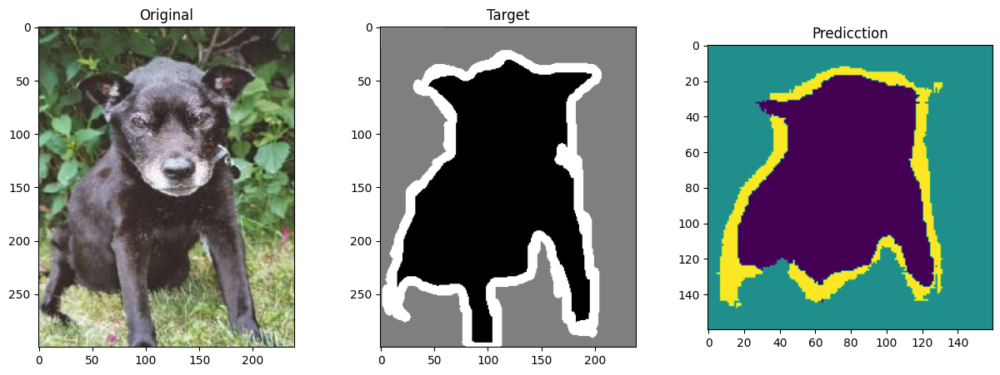

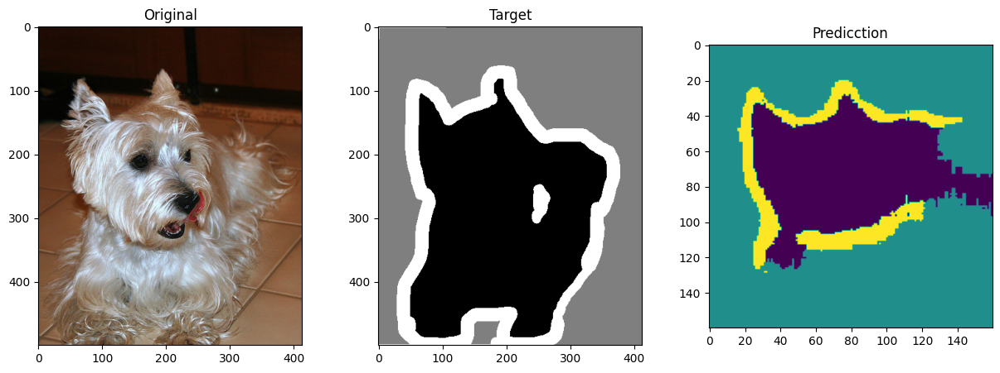

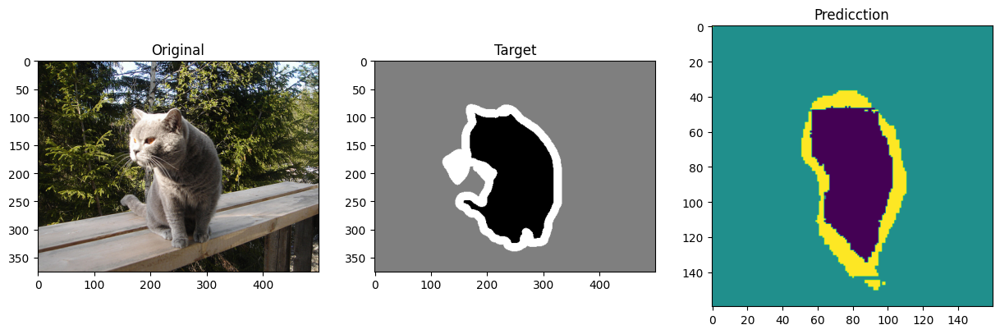

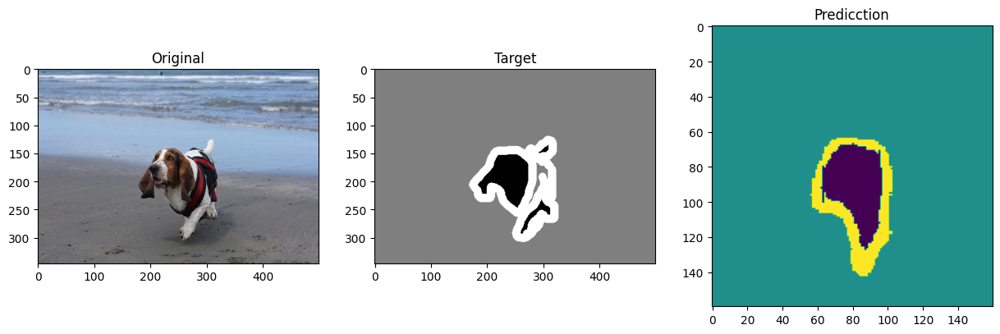

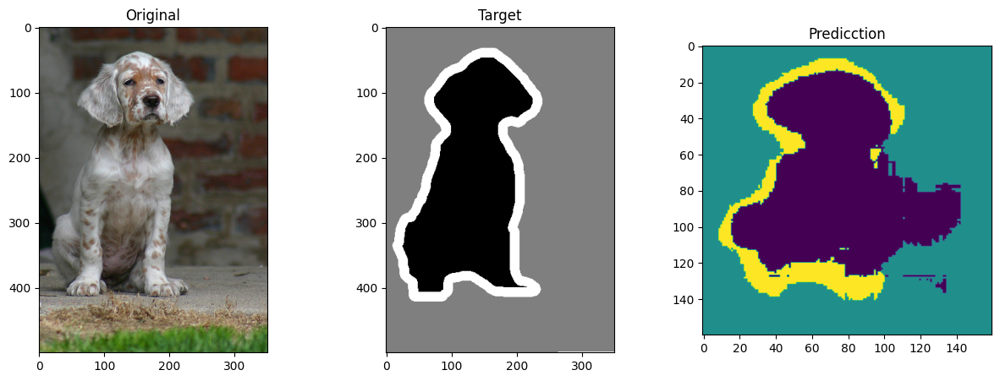

In [35]:
import matplotlib.pyplot as plt
from keras.utils import load_img
from PIL import ImageOps


#Definimos un pequeño metodo para mostrar las imagenes y predicciones en una misma imagen
def display_images(images, titles):
    num_images = len(images)

    # Un subgrafico por imagen
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

    # Iterar sobre las imágenes y títulos y mostrarlas en los subgráficos
    for i in range(num_images):
        axes[i].imshow(images[i])
        axes[i].set_title(titles[i])
    plt.show()


val_dataset = get_dataset(
    batch_size, img_size, val_images, val_target
)
val_preds = model2.predict(val_dataset)


# Índices de las 5 imaágenes a mostrar
selected_indices = [ 15 ,25, 30, 5, 100]

# Muestra ejemplos seleccionados
for i in selected_indices:
    # Imagen original
    input_img = load_img(val_images[i])

    #  Mostramos la mascara
    target_img = ImageOps.autocontrast(load_img(val_target[i]))

    # Finalmente la prediccion
    mask_img = np.argmax(val_preds[i], axis=-1)
    mask_img = np.expand_dims(mask_img, axis=-1)
    mask_img = ImageOps.autocontrast(keras.utils.array_to_img(mask_img))

    # Mostramos cada una de ellas
    display_images([input_img, target_img, mask_img], ["Original", "Target", "Predicction"])


Imágenes nuevas

1/1 [==============================] - 0s 18ms/step


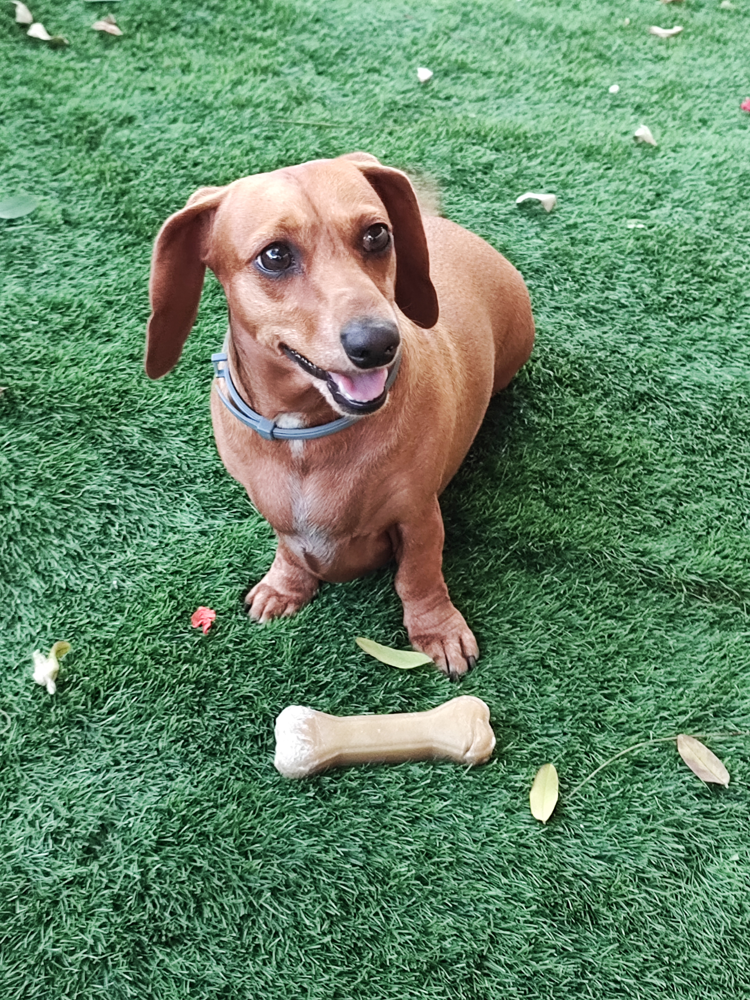

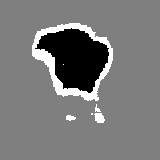

1/1 [==============================] - 0s 23ms/step


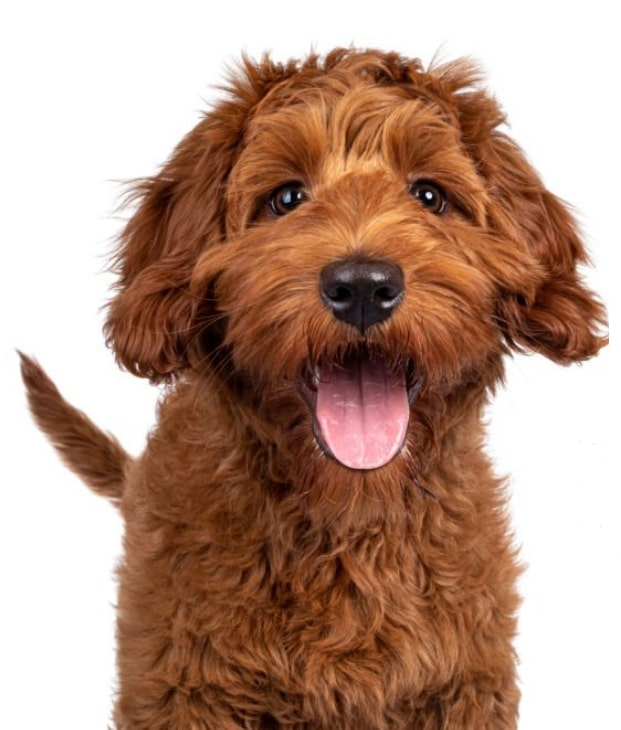

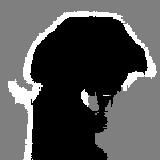

1/1 [==============================] - 0s 19ms/step


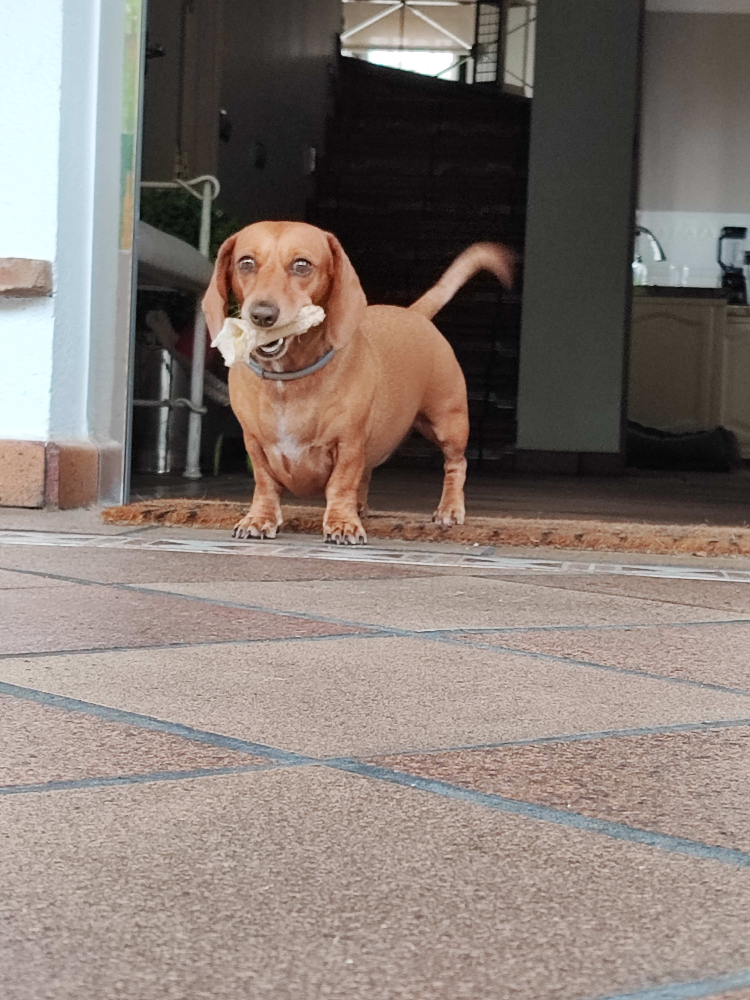

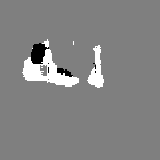

1/1 [==============================] - 0s 23ms/step


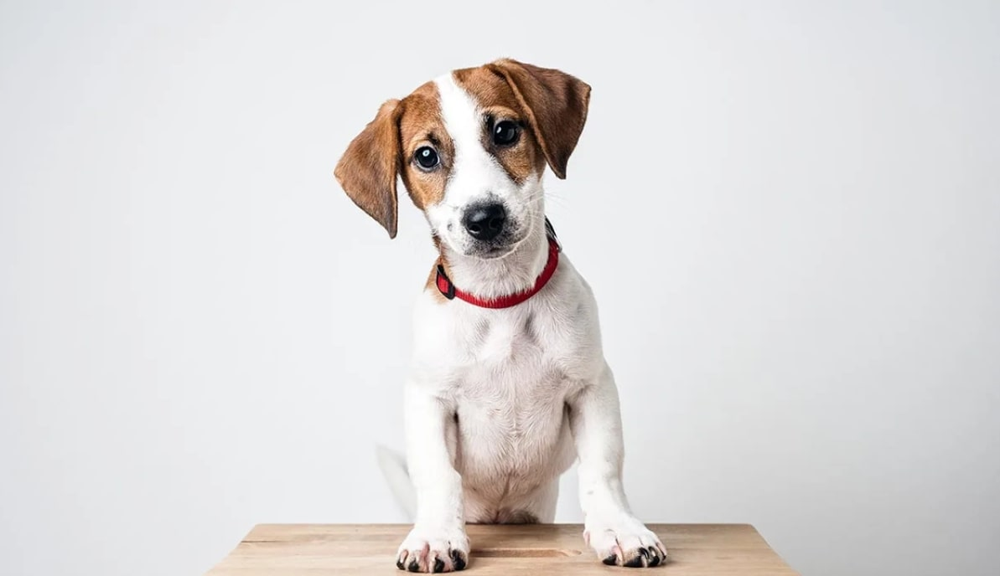

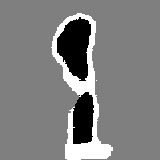

1/1 [==============================] - 0s 18ms/step


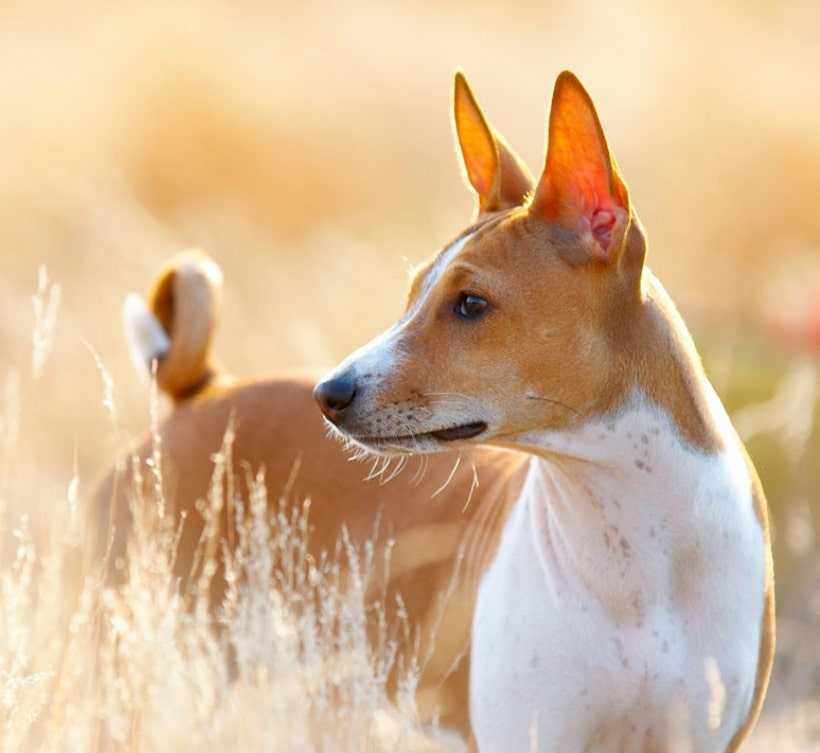

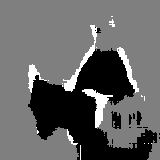

1/1 [==============================] - 0s 20ms/step


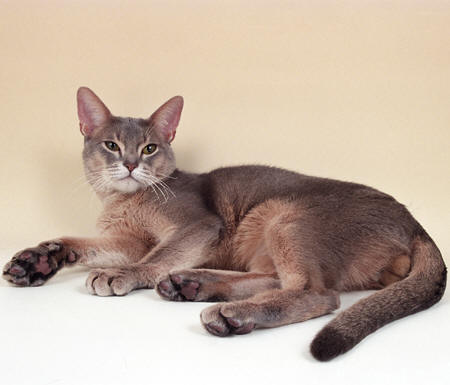

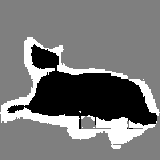

In [39]:
from os import listdir
from os.path import isfile, join
import keras
import numpy as np
import tensorflow as tf
from tensorflow import data as tf_data
from tensorflow import image as tf_image
from tensorflow import io as tf_io


# cargamos el directorio con las imágenes de internet y las metemos en images
path = "perros/"

#Obtenemos el nombre d elos archivos para el for
image = [f for f in listdir(path) if isfile(join(path, f))]


# Esta parte es como el ejemplo de keras

# Itera sobre cada imagen y muestra la imagen y la predicción
for image_file in image:
    # Construye la ruta completa de la imagen
    image_path = join(path, image_file)

    # Cargamos y procesamos la imagen como en el conjunto del ejemplo
    internet_img = tf_io.read_file(image_path)
    #decodificamos y especificamos 3 canales 
    internet_img = tf_io.decode_png(internet_img, channels=3)
    # ajustamos el tamaño a la entrada
    internet_img = tf_image.resize(internet_img, (160, 160))  
    internet_img = tf_image.convert_image_dtype(internet_img, "float32")
    internet_img_array = tf.expand_dims(internet_img, axis=0)

    # calculamos la predicción 
    prediction = model2.predict(internet_img_array)

    # transformamos la máscara a imagen para ver el resultaod d ela predicción
    prediction = np.argmax(prediction[0], axis=-1)
    prediction = np.expand_dims(prediction, axis=-1)
    prediction = ImageOps.autocontrast(tf.keras.utils.array_to_img(prediction))

    # Mostramos imagen y predicción por cada imagen
    display(Image(filename=image_path, width=160, height=160))  # Ajusta el tamaño a 160x160
    display(prediction)


## <center> Modelo 2</center>

Este segundo ejemplo tenemos un resultado algo peor que el anterior a costa de tener un modelo más rápido y sencillo, detecta mas o menos las siluetas pero tiene problemas para identificar algunas partes de los animales con respecto al fondo

En las imágenes de internet el resultado es más irregular, detecta en la imagen las zonas donde se situa el animal , pero presenta problemas para representar a este y su contorno

Imágenes del conjunto

24/24 [==============================] - 1s 25ms/step


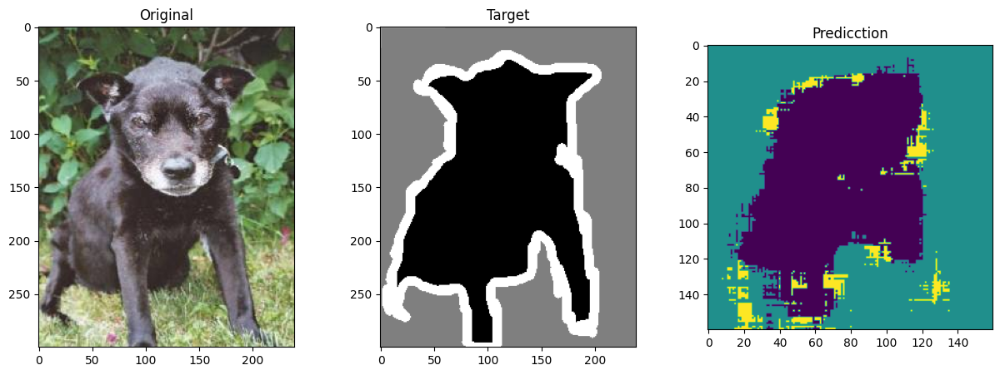

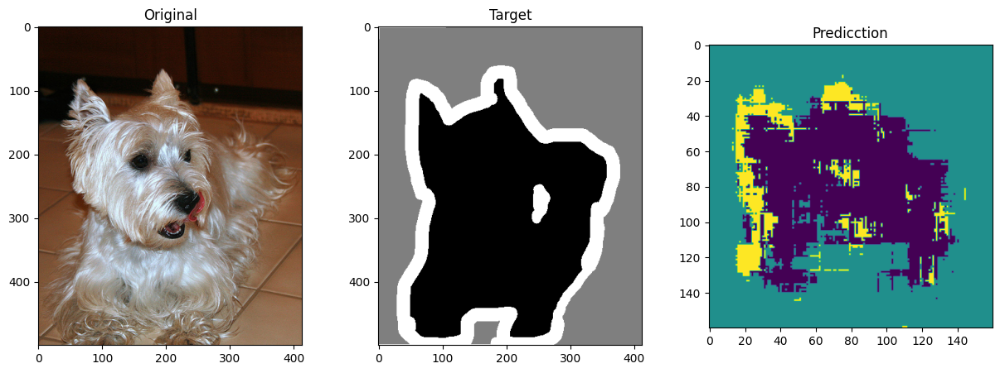

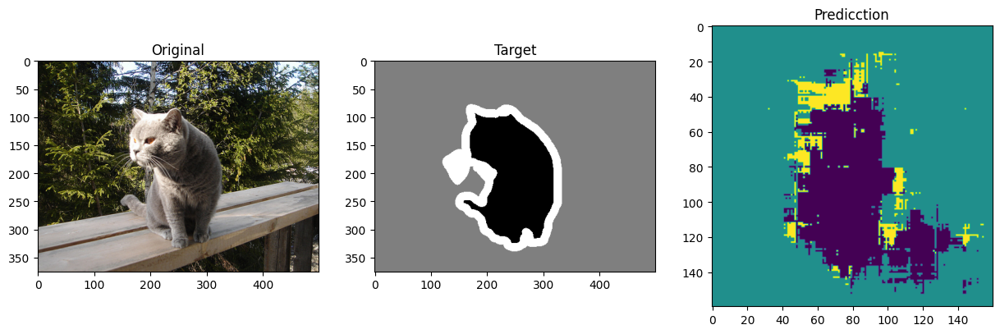

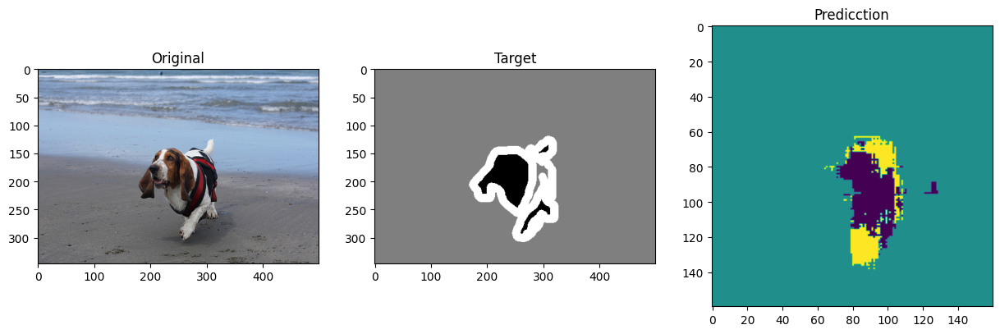

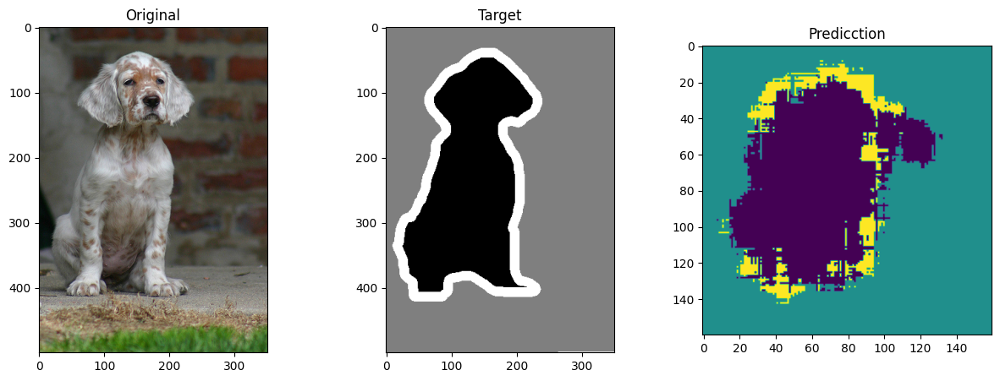

In [37]:
import matplotlib.pyplot as plt
from keras.utils import load_img
from PIL import ImageOps

#Definimos un pequeño metodo para mostrar las imagenes y predicciones en una misma imagen

val_preds = model.predict(val_dataset)

# Índices de las 5 imaágenes a mostrar
selected_indices = [ 15 ,25, 30, 5, 100]

# Muestra ejemplos seleccionados
for i in selected_indices:
    # Imagen original
    input_img = load_img(val_images[i])

    #  Mostramos la mascara
    target_img = ImageOps.autocontrast(load_img(val_target[i]))

    # Finalmente la prediccion
    mask_img = np.argmax(val_preds[i], axis=-1)   
    mask_img = np.expand_dims(mask_img, axis=-1) 
    mask_img = ImageOps.autocontrast(keras.utils.array_to_img(mask_img))

    # Mostramos cada una de ellas
    display_images([input_img, target_img, mask_img], ["Original", "Target", "Predicction"])
    

Imágenes nuevas

1/1 [==============================] - 0s 13ms/step


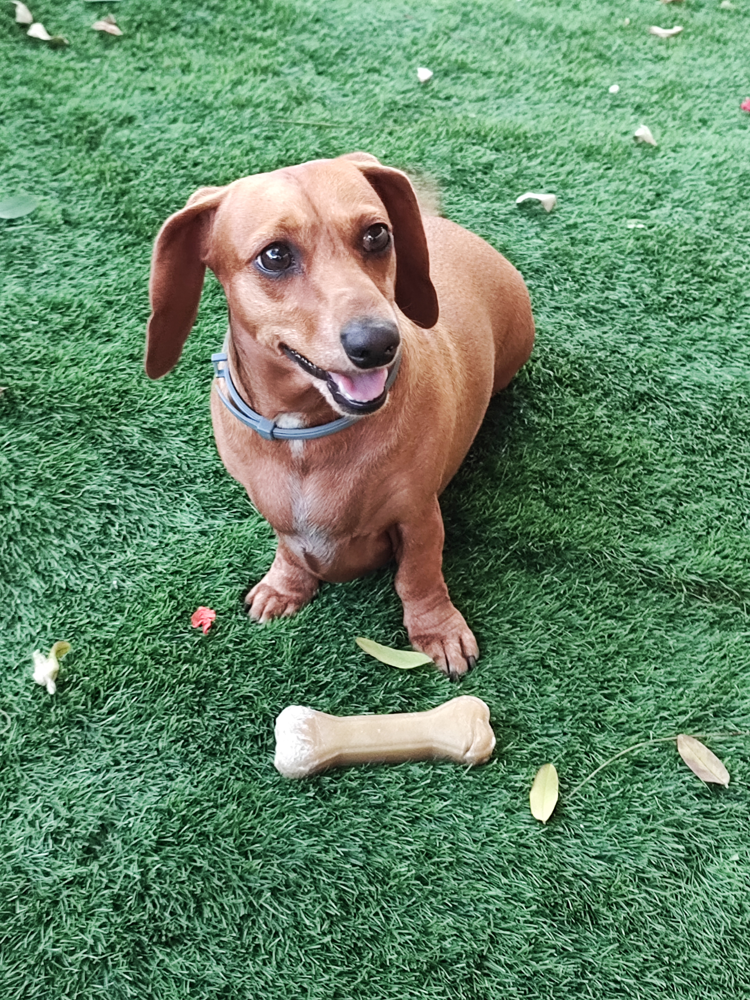

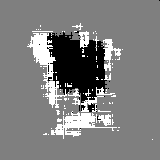

1/1 [==============================] - 0s 14ms/step


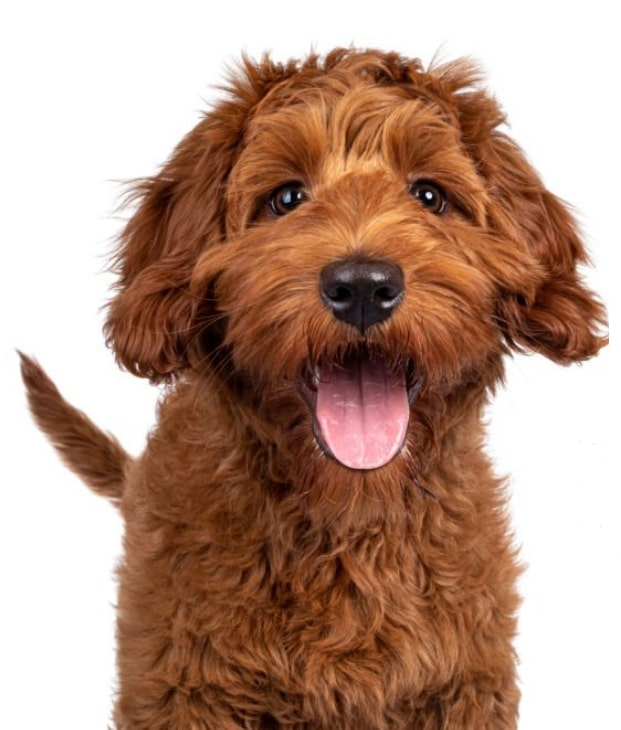

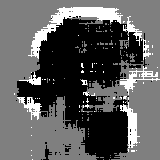

1/1 [==============================] - 0s 13ms/step


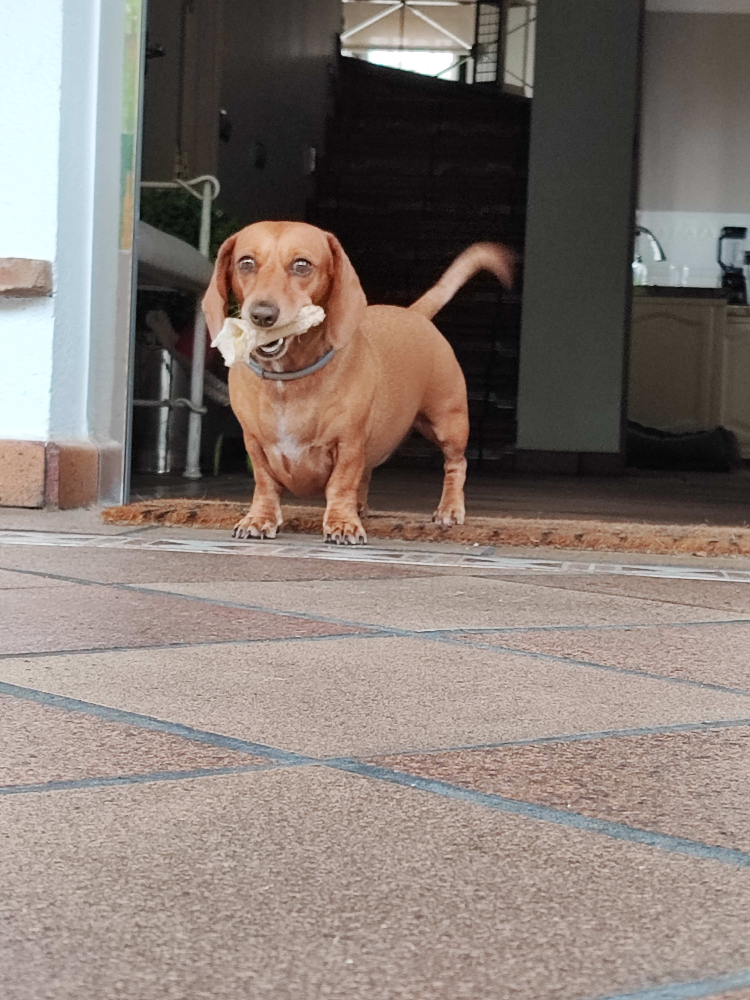

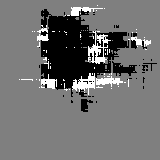

1/1 [==============================] - 0s 18ms/step


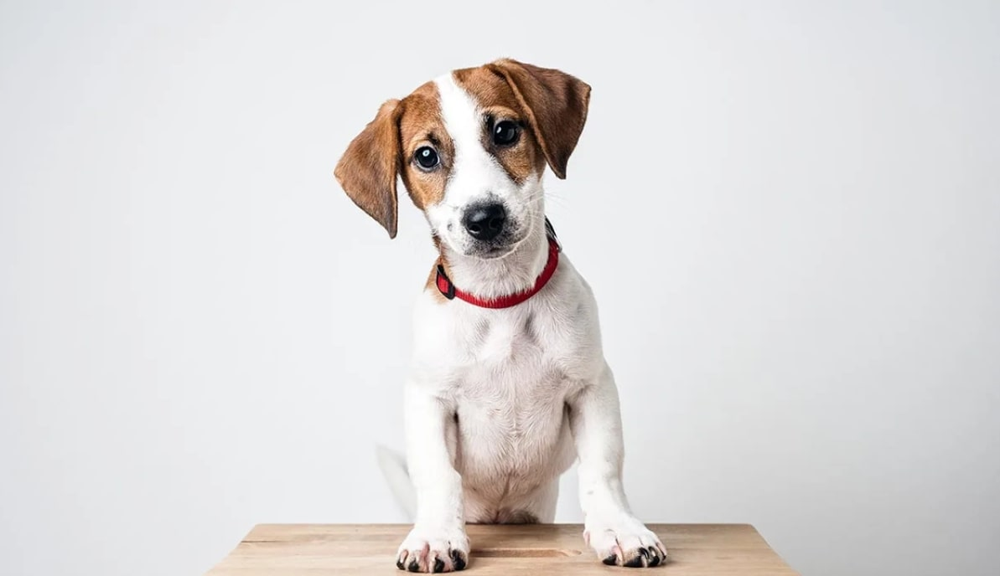

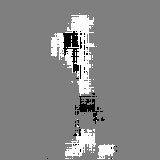

1/1 [==============================] - 0s 19ms/step


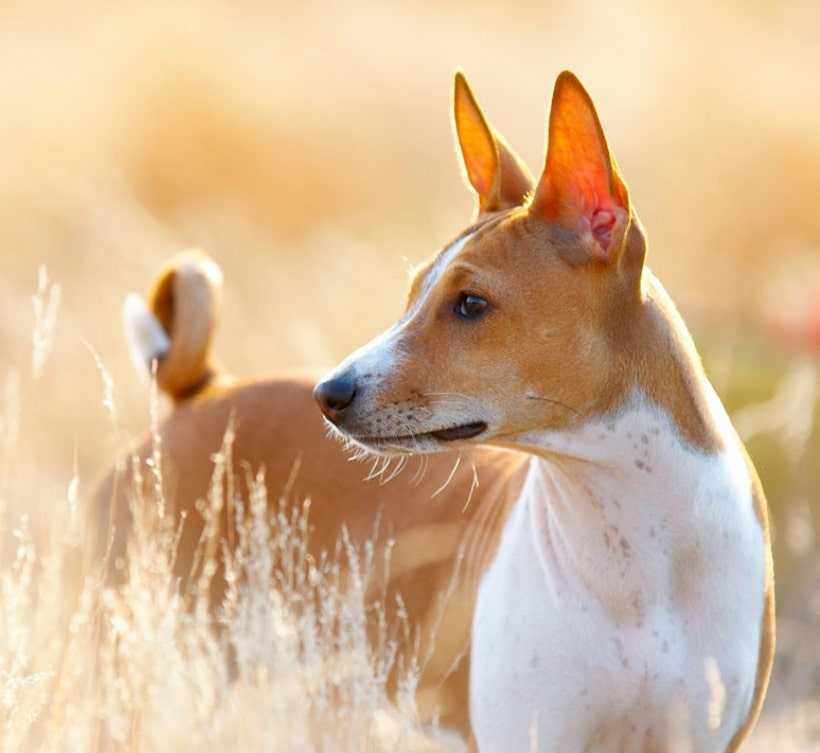

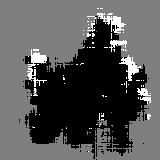

1/1 [==============================] - 0s 14ms/step


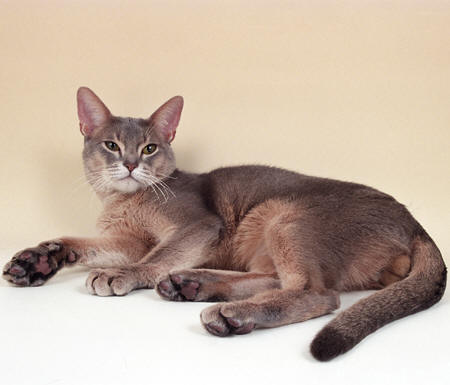

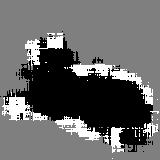

In [40]:
# Itera sobre cada imagen y muestra la imagen y la predicción
for image_file in image:
    # ruta completa de la imagen
    image_path = join(path, image_file)

    # Cargamos y procesamos la imagen como en el conjunto del ejemplo
    internet_img = tf_io.read_file(image_path)
    #decodificamos y especificamos 3 canales 
    internet_img = tf_io.decode_png(internet_img, channels=3)
    # ajustamos el tamaño a la entrada
    internet_img = tf_image.resize(internet_img, (160, 160))  
    internet_img = tf_image.convert_image_dtype(internet_img, "float32")
    internet_img_array = tf.expand_dims(internet_img, axis=0)

    # calculamos la predicción con el modelo
    prediction = model.predict(internet_img_array)

    # transformamos la máscara a imagen para ver el resultaod d ela predicción
    prediction = np.argmax(prediction[0], axis=-1)
    prediction = np.expand_dims(prediction, axis=-1)
    prediction = ImageOps.autocontrast(tf.keras.utils.array_to_img(prediction))

    # Mostramos imagen y predicción por cada imagen
    display(Image(filename=image_path, width=160, height=160))  # Ajusta el tamaño a 160x160
    display(prediction)


# Bibliografía utilizada (enlaces web, material de clase, libros, etc.).

https://keras.io/examples/vision/oxford_pets_image_segmentation/

Diapositivas y videos de clase

https://colab.research.google.com/github/miguelamda/DL/blob/master/7.%20Modelos%20Generativos/Practica7.5.%20Introducci%C3%B3n%20a%20VAEs.ipynb

https://pyimagesearch.com/2022/02/21/u-net-image-segmentation-in-keras/

https://youtu.be/3v7sYqigeSc?si=Gx3m3ph7xAY3j0Ul